# Temperature, Salinity, and Stratification #


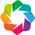

In [1]:
import xarray as xr
from matplotlib import pyplot as plt
from IPython.display import SVG, display, Image, display_svg
import seaborn
import numpy as np
import gsw
seaborn.set(font_scale=2)
%matplotlib inline
import holoviews as hv
hv.extension('bokeh')
plt.rcParams['figure.figsize'] = (12,7)

In [ ]:
# masks
woa_mask = xr.open_dataset('http://iridl.ldeo.columbia.edu/SOURCES/.NOAA/.NODC/.WOA09/'
                             '.Masks/.basin/dods/').rename({'X':'lon', 'Y':'lat', 'Z': 'depth'})
basin_names = woa_mask.basin.attrs['CLIST'].split('\n')
basins_main = { n: basin_names[n-1] for n in [1,2,3,10] }
basins_marginal = { n: basin_names[n-1] for n in [4,5,6,7,11] }

In [ ]:
# data
url_base = 'http://iridl.ldeo.columbia.edu/SOURCES/.NOAA/.NODC/.WOA09/.Grid-1x1/.Annual'
url_temp = url_base + '/.temperature/.t_an/dods'
url_salt = url_base + '/.salinity/.s_an/dods '
woa_temp = xr.open_dataset(url_temp)
woa_temp_nobs = xr.open_dataarray(url_base + '/.temperature/.t_dd/dods')
woa_salt = xr.open_dataset(url_salt)
woa = xr.merge([woa_temp, woa_salt, woa_temp_nobs, woa_mask]).isel(time=0)
woa.load()

In [ ]:
pres = gsw.p_from_z(-woa.depth, 0)[:,None,None]
s_a = gsw.SA_from_SP(woa.s_an,
                     pres,
                     woa.lon.data[None,None,:],
                     woa.lat.data[None,:,None])
c_t = gsw.CT_from_t(s_a, woa.t_an, pres)
sigma_0 = gsw.sigma0(s_a, c_t)
sigma_2 = gsw.sigma2(s_a, c_t)
sigma_4 = gsw.sigma4(s_a, c_t)

for data, label in ((s_a, 's_a'), (c_t, 'c_t'),
                    (sigma_0, 'sigma_0'), (sigma_2, 'sigma_2'), (sigma_4, 'sigma_4')):
    woa[label] = xr.DataArray(data, dims=woa.t_an.dims, coords=woa.t_an.coords)

woa

In [5]:
%%opts Image [logz=True width=600 colorbar=True toolbar='above']
hv.Dataset(woa.t_dd).to(hv.Image, ['lon', 'lat'], label='Number of Observations')

:HoloMap   [depth]
   :Image   [lon,lat]   (t_dd)

In [5]:
def map_section_plot(data, label, data_range, levels, cmap='viridis'):
    ds = hv.Dataset(data)
    img = ds.to(hv.Image, ['lon', 'lat'], label=label)
    img = img.redim.range(**{data.name: data_range})

    posx = hv.streams.PointerX()
    vline = hv.DynamicMap(lambda x: hv.VLine(x or 180.5), streams=[posx])

    lats = np.arange(-90, 91)
    def cross_section(x):
        mesh = hv.QuadMesh((lats, woa.depth, data.sel(lon=x if x else 180, method='nearest').data[:-1]),
                           kdims=['lat', 'depth'], label=(label + ' Section'))
        contours = hv.operation.contours(mesh, levels=levels,
                                         overlaid=False, filled=True)
        return contours

    
    crosssection = hv.DynamicMap(cross_section, streams=[posx])
    layout = (img * vline) + crosssection 
    
    # set view options
    dict_spec = {'Image': {'plot': dict(colorbar=True, toolbar='above', width=600),
                           'style': dict(cmap=cmap)},
                 'NdOverlay': {'plot': dict(bgcolor='grey', invert_yaxis=True, width=600, height=200)},
                 'Layout': {'plot': dict(show_title=False)},
                 'Polygons': {'plot': dict(colorbar=True), 'style': dict(cmap=cmap, line_width=0.1)}
                 }
    layout.cols(1)
    layout = layout.opts(dict_spec)   
    return layout

In [6]:
map_section_plot(woa.t_an, 'Temperature', (-2,30), np.arange(-2,31), cmap='RdBu_r')

:Layout
   .DynamicMap.I  :DynamicMap   [depth]
   .DynamicMap.II :DynamicMap   []

In [8]:
map_section_plot(woa.s_an, 'Salinity', (32,38), np.arange(32,38.1, 0.25))

:Layout
   .DynamicMap.I  :DynamicMap   [depth]
   .DynamicMap.II :DynamicMap   []

In [9]:
map_section_plot(woa.sigma_0, 'Potential Density (sigma0)', (22.,28.), np.arange(22,28.1, 0.25))

:Layout
   .DynamicMap.I  :DynamicMap   [depth]
   .DynamicMap.II :DynamicMap   []

In [10]:
woa['thick'] = woa.depth.diff(dim='depth')
woa['thick'][0] = 5
# add an area element
earth_radius =  6.371e6
tot_area = (4 * np.pi * earth_radius**2)

woa['area'] = (earth_radius**2 *
               np.radians(1.) * np.radians(1.) *
               np.cos(np.radians(woa.lat)))
t, s, dz, a, basin = xr.broadcast_arrays(
                *xr.align(
                    woa['t_an'], woa['s_an'],
                    woa['thick'], woa['area'], woa['basin']
                )
              )
vol = dz*a

/Users/rpa/miniconda3/envs/geo_scipy/lib/python3.6/site-packages/ipykernel_launcher.py:13: DeprecationWarning: xarray.broadcast_arrays is deprecated: use xarray.broadcast instead
  del sys.path[0]


/Users/rpa/miniconda3/envs/geo_scipy/lib/python3.6/site-packages/numpy/lib/function_base.py:748: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= mn)
/Users/rpa/miniconda3/envs/geo_scipy/lib/python3.6/site-packages/numpy/lib/function_base.py:749: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= mx)


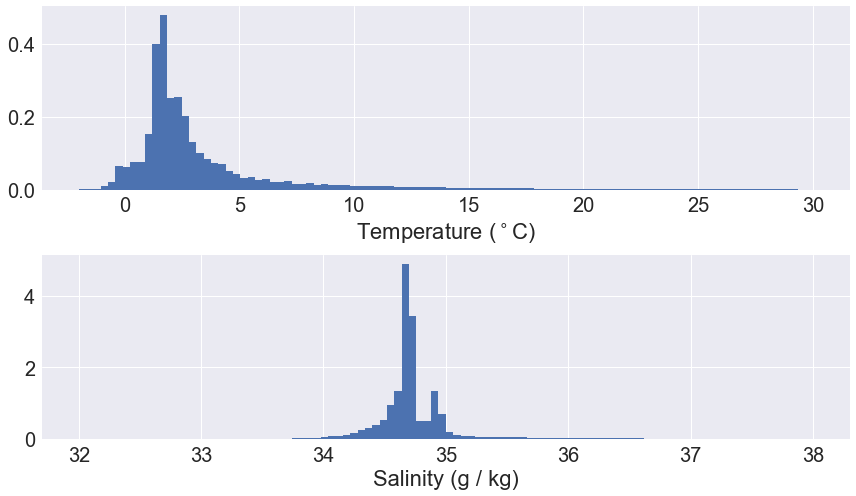

In [11]:
fig, (ax1, ax2) = plt.subplots(2)

ax1.hist(t.where(t).values.ravel(), bins=100, normed=True, range=(-2,30),
         weights=vol.where(t).values.ravel());
ax2.hist(s.where(s).values.ravel(), bins=100, normed=True, range=(32,38),
         weights=vol.where(s).values.ravel());
ax1.set_xlabel(r'Temperature ($^\circ$C)')
ax2.set_xlabel("Salinity (g / kg)")
plt.tight_layout()

## Temperature and Salinity Distribution

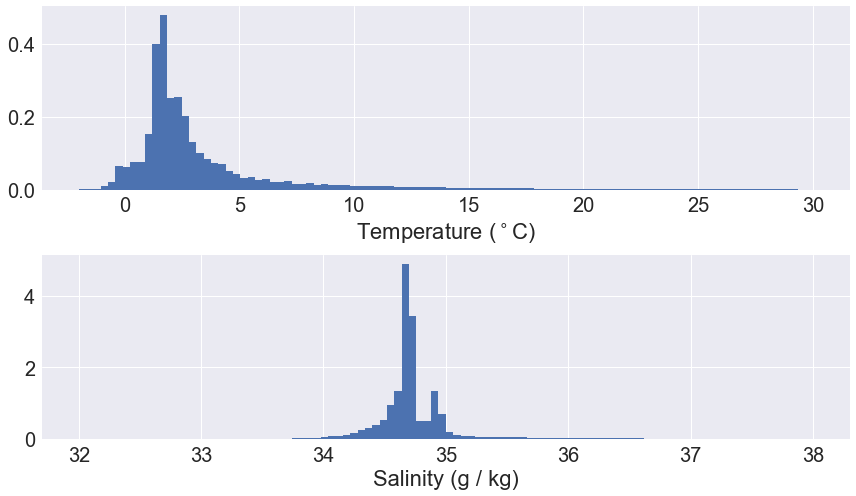

In [12]:
fig

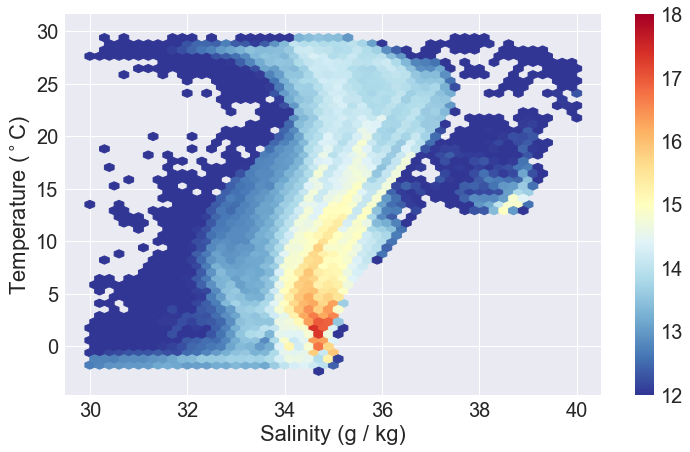

In [13]:
from matplotlib.colors import LogNorm
fig, ax = plt.subplots()
hb = ax.hexbin(s.values.ravel(), t.values.ravel(),
           C=vol.values.ravel(), reduce_C_function=np.sum,
           extent=(30,40,-3,30), gridsize=50, bins='log',
           cmap='RdYlBu_r')
plt.colorbar(hb)
ax.set_ylabel(r'Temperature ($^\circ$C)')
ax.set_xlabel("Salinity (g / kg)")
hb.set_clim([12,18])

## Joint T/S Distribution

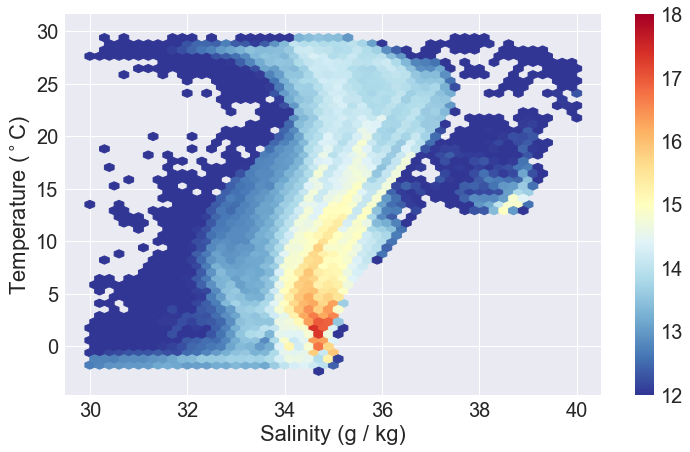

In [14]:
fig

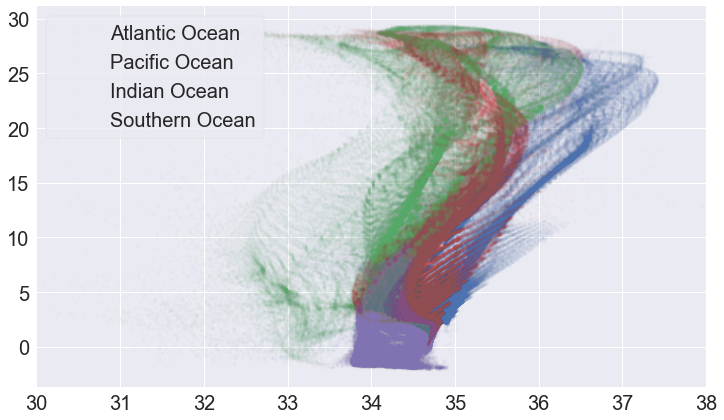

In [15]:
pal = seaborn.palettes.color_palette(n_colors=len(basins_main))
fig, ax = plt.subplots()
for (bnum, bname), col in zip(basins_main.items(), pal):
    ax.plot(s.where(basin==bnum).values.ravel(), t.where(basin==bnum).values.ravel(),
             '.', color=col,
                alpha=0.02, label=bname
               )
ax.set_xlim(30,38)
ax.legend(loc='upper left', frameon=True)
# blue green red purple

## T/S Distribution by Basin

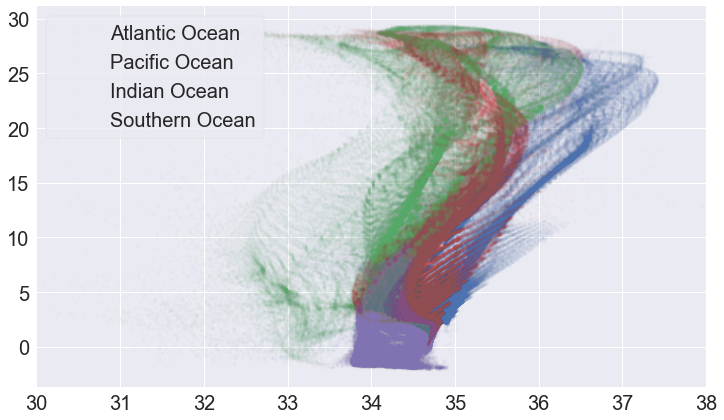

In [16]:
fig

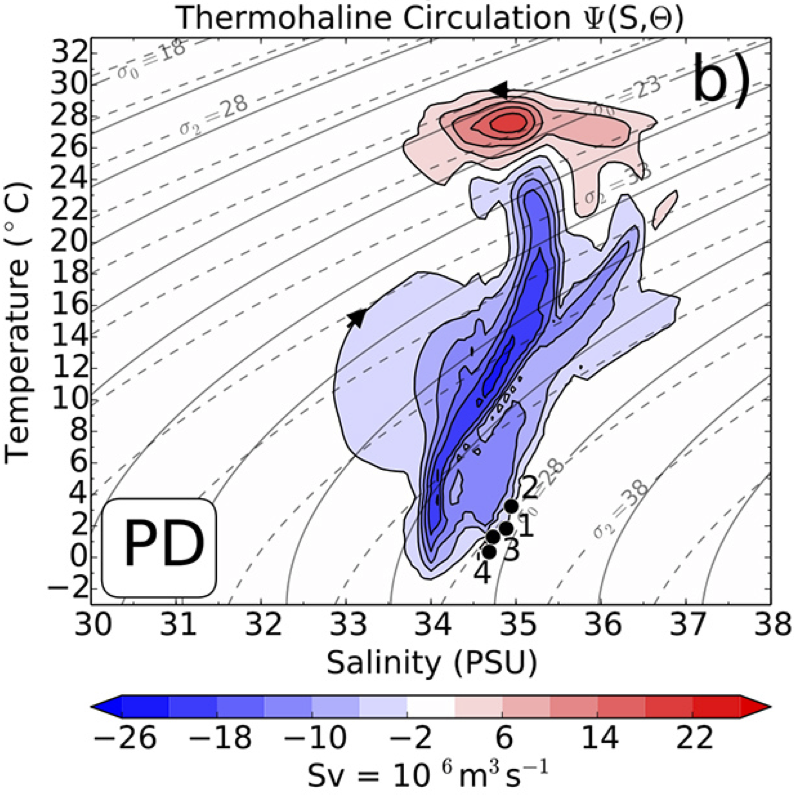

In [17]:
Image("02_images/THC_Ballarotta2014.png", width=600)

In [18]:
# the goods are here
# https://www.nodc.noaa.gov/OC5/3M_HEAT_CONTENT/
# http://data.nodc.noaa.gov/thredds/catalog/woa/heat_content/heat_content/catalog.html
url = ('https://data.nodc.noaa.gov/thredds/dodsC/woa/heat_content/'
       'heat_content/heat_content_anomaly_0-700_pentad.nc')
hc = xr.open_dataset(url, decode_times=False).load()
hc

<xarray.Dataset>
Dimensions:             (depth: 1, lat: 180, lon: 360, nbounds: 2, time: 58)
Coordinates:
  * lat                 (lat) float32 -89.5 -88.5 -87.5 -86.5 -85.5 -84.5 ...
  * lon                 (lon) float32 -179.5 -178.5 -177.5 -176.5 -175.5 ...
  * time                (time) float32 30.0 42.0 54.0 66.0 78.0 90.0 102.0 ...
Dimensions without coordinates: depth, nbounds
Data variables:
    crs                 int64 -2147483647
    lat_bnds            (lat, nbounds) float32 -90.0 -89.0 -89.0 -88.0 -88.0 ...
    lon_bnds            (lon, nbounds) float32 -180.0 -179.0 -179.0 -178.0 ...
    depth_bnds          (depth, nbounds) float32 0.0 700.0
    climatology_bounds  (time, nbounds) float32 0.0 60.0 12.0 72.0 24.0 84.0 ...
    h18_hc              (time, depth, lat, lon) float64 nan nan nan nan nan ...
    pent_h22_WO         (time) float32 -6.28869 -4.89276 -5.78406 -3.38743 ...
    pent_h22_se_WO      (time) float32 1.84269 1.83688 1.83623 1.71795 ...
    pent_h22_NH     

In [19]:
# fix time to something xray likes
hc['time'] *= (365/12.)
tunits = hc.time.attrs['units'].replace('months', 'days')
hc['time'].attrs['units'] = tunits
hc = xr.decode_cf(hc)

/Users/rpa/Code/xarray/xarray/conventions.py:909: UserWarning: CF decoding is overwriting dtype
  warnings.warn("CF decoding is overwriting dtype")


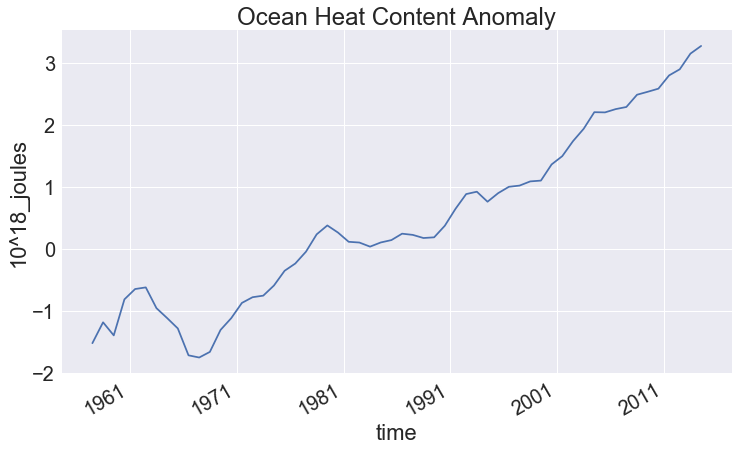

In [20]:
fig, ax = plt.subplots()
hc['h18_hc'].mean(dim=('lon','lat','depth')).plot(ax=ax)
ax.set_ylabel(hc.h18_hc.attrs['units'])
plt.title('Ocean Heat Content Anomaly')

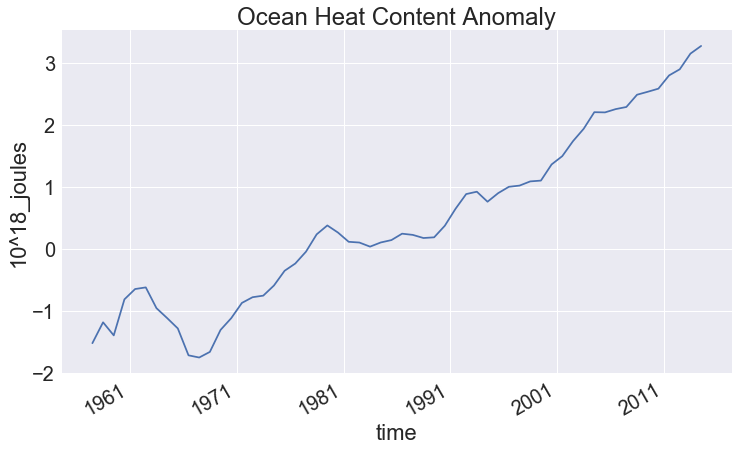

In [21]:
fig